https://github.com/eriklindernoren/PyTorch-GAN/tree/master

In [118]:
import argparse
import os
import numpy as np
import math

import torchvision.transforms as transforms
from torchvision.utils import save_image

from torch.utils.data import DataLoader
from torchvision import datasets
from torch.autograd import Variable

import torch.nn as nn
import torch.nn.functional as F
import torch
from torch import optim
import os
import torchvision.utils as vutils
import numpy as np
from torchvision import datasets
from torchvision import transforms
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision.datasets import SVHN 
import shutil
from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt

In [119]:



GAN_LOGS = os.path.join(os.getcwd(), "ctboard_logs", "cgan")
if  os.path.exists(GAN_LOGS):
    shutil.rmtree(GAN_LOGS)
if not os.path.exists(GAN_LOGS):
    os.makedirs(GAN_LOGS)

writer = SummaryWriter(GAN_LOGS)

samples_path = os.path.join('samples')

if  os.path.exists(samples_path):
    shutil.rmtree(samples_path)

if not os.path.exists(samples_path):
    os.makedirs(samples_path)


# os.makedirs(samples_path, exist_ok=True)

model_path=os.path.join('models')
os.makedirs(model_path, exist_ok=True)

In [120]:

n_epochs=40
batch_size=64
lr=0.0002
latent_dim=100
n_classes=10
img_size=32 
channels=3
sample_interval=400 


In [121]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [122]:

img_shape = (channels, img_size, img_size)

In [123]:
# Data loader
transform = transforms.Compose([
                                transforms.ToTensor(),
                                transforms.Normalize([0.5], [0.5])])


dataset = SVHN(split='train',root='data/train',transform=transform,download=False)


dataloader = torch.utils.data.DataLoader(dataset=dataset, 
                                        batch_size=batch_size, 
                                        shuffle=True, 
                                        num_workers=4,
                                        drop_last=True)

In [124]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()

        self.label_emb = nn.Embedding(n_classes, n_classes)

        def block(in_feat, out_feat, normalize=True):
            layers = [nn.Linear(in_feat, out_feat)]
            if normalize:
                layers.append(nn.BatchNorm1d(out_feat, 0.8))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *block(latent_dim + n_classes, 128, normalize=False),
            *block(128, 256),
            *block(256, 512),
            *block(512, 1024),
            nn.Linear(1024, int(np.prod(img_shape))),
            nn.Tanh()
        )

    def forward(self, noise, labels):
        # Concatenate label embedding and image to produce input
        gen_input = torch.cat((self.label_emb(labels), noise), -1)
        img = self.model(gen_input)
        img = img.view(img.size(0), *img_shape)
        return img


In [125]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        self.label_embedding = nn.Embedding(n_classes, n_classes)

        self.model = nn.Sequential(
            nn.Linear(n_classes + int(np.prod(img_shape)), 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 512),
            nn.Dropout(0.4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 512),
            nn.Dropout(0.4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 1),
        )

    def forward(self, img, labels):
        # Concatenate label embedding and image to produce input
        d_in = torch.cat((img.view(img.size(0), -1), self.label_embedding(labels)), -1)
        validity = self.model(d_in)
        return validity


In [126]:
IMGS_TO_DISPLAY_PER_CLASS = 10

In [127]:
def sample_image(n_row, batches_done):
    """Saves a grid of generated digits ranging from 0 to n_classes"""
    # Sample noise
    z = Variable(FloatTensor(np.random.normal(0, 1, (n_row ** 2, latent_dim))))
    # Get labels ranging from 0 to n_classes for n rows
    labels = np.array([num for _ in range(n_row) for num in range(n_row)])
    labels = Variable(LongTensor(labels))
    gen_imgs = generator(z, labels)
    # print(gen_imgs.shape)
    # save_image(gen_imgs.data, "images/%d.png" % batches_done, nrow=n_row, normalize=True)
    gen_imgs = (gen_imgs + 1) / 2
    gen_imgs_ = vutils.make_grid(gen_imgs.data.cpu(), normalize=False, nrow=IMGS_TO_DISPLAY_PER_CLASS)
    writer.add_image('images', gen_imgs_, global_step=batches_done)
    plt.imshow(gen_imgs_.permute(1,2,0).numpy())
    plt.show()
    # vutils.save_image(gen_imgs_, os.path.join(samples_path, 'sample_' + str(batches_done) + '.png'))


In [128]:
# Loss functions
adversarial_loss = torch.nn.MSELoss()

# Initialize generator and discriminator
generator = Generator()
discriminator = Discriminator()

generator.to(device)
discriminator.to(device)
adversarial_loss.to(device)

# Optimizers
optimizer_G = torch.optim.Adam(generator.parameters(), lr=lr)
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=lr)

FloatTensor = torch.cuda.FloatTensor 
LongTensor = torch.cuda.LongTensor


#### Train the model for conditional generation on the SVHN dataset

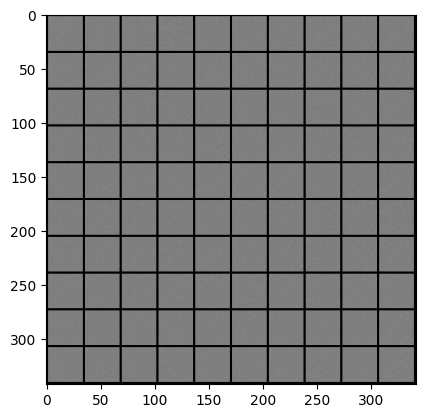

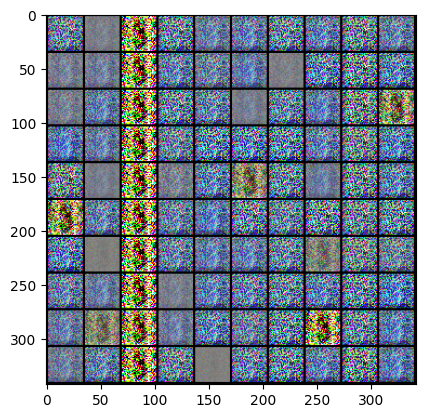

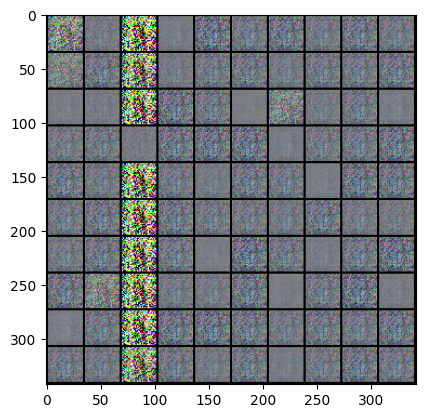

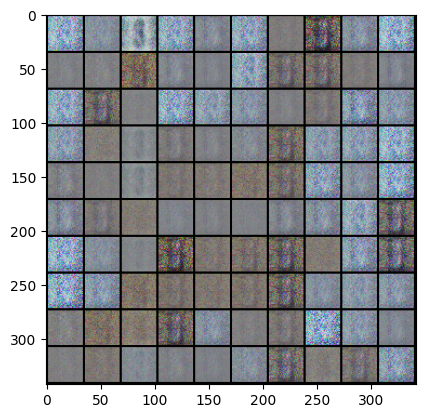

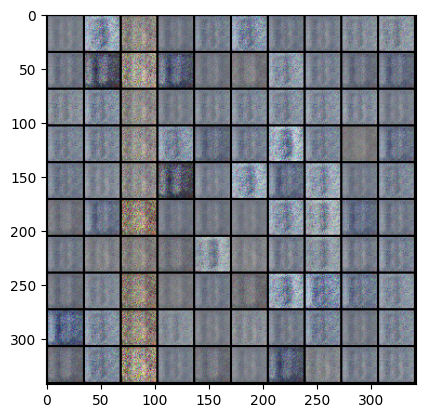

...

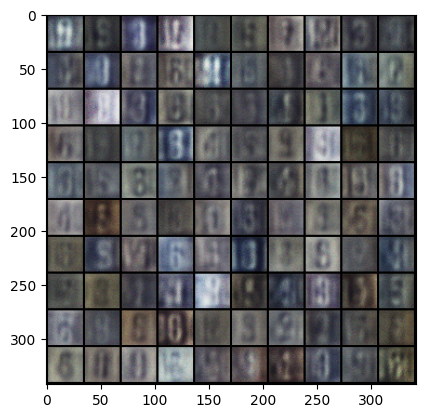

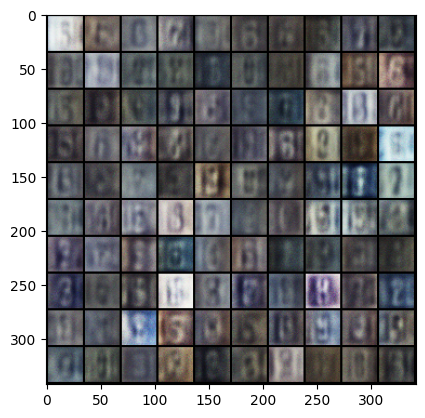

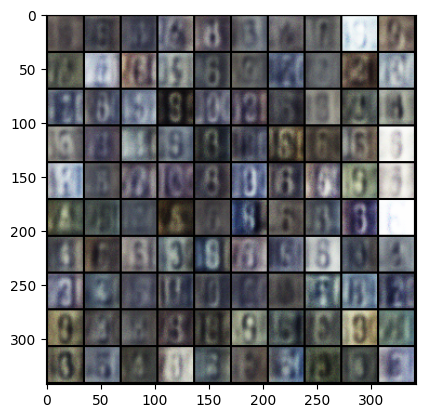

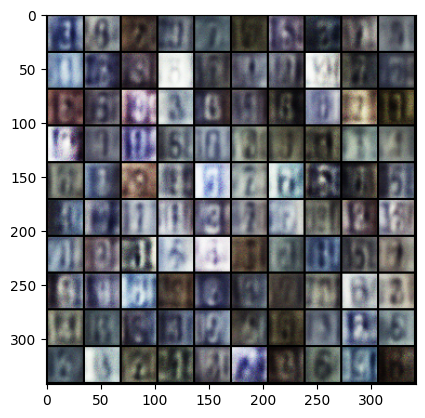

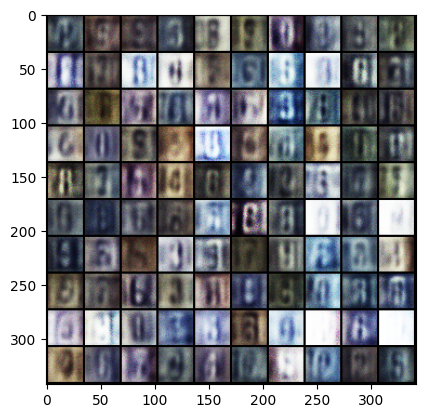

In [129]:
iter_ = 0
for epoch in range(n_epochs):
    for i, (imgs, labels) in enumerate(dataloader):

        batch_size = imgs.shape[0]

        # Adversarial ground truths
        valid = Variable(FloatTensor(batch_size, 1).fill_(1.0), requires_grad=False)
        fake = Variable(FloatTensor(batch_size, 1).fill_(0.0), requires_grad=False)

        # Configure input
        real_imgs = Variable(imgs.type(FloatTensor))
        labels = Variable(labels.type(LongTensor))

        # -----------------
        #  Train Generator
        # -----------------

        optimizer_G.zero_grad()

        # Sample noise and labels as generator input
        z = Variable(FloatTensor(np.random.normal(0, 1, (batch_size, latent_dim))))
        gen_labels = Variable(LongTensor(np.random.randint(0, n_classes, batch_size)))

        # Generate a batch of images
        gen_imgs = generator(z, gen_labels)

        # Loss measures generator's ability to fool the discriminator
        validity = discriminator(gen_imgs, gen_labels)
        g_loss = adversarial_loss(validity, valid)

        g_loss.backward()
        optimizer_G.step()

        # ---------------------
        #  Train Discriminator
        # ---------------------

        optimizer_D.zero_grad()

        # Loss for real images
        validity_real = discriminator(real_imgs, labels)
        d_real_loss = adversarial_loss(validity_real, valid)

        # Loss for fake images
        validity_fake = discriminator(gen_imgs.detach(), gen_labels)
        d_fake_loss = adversarial_loss(validity_fake, fake)

        # Total discriminator loss
        d_loss = (d_real_loss + d_fake_loss) / 2

        d_loss.backward()
        optimizer_D.step()
        writer.add_scalar(f'Loss/Generator Loss', g_loss.item(), global_step=iter_)
        writer.add_scalar(f'Loss/Discriminator Loss', d_real_loss.item(), global_step=iter_)
        writer.add_scalars(f'Loss/Discriminator Losses', {
                        "Real Images Loss": d_real_loss.item(),
                        "Fake Images Loss": d_fake_loss.item(),
                    }, global_step=iter_)
        writer.add_scalars(f'Comb_Loss/Losses', {
                            'Discriminator': d_loss.item(),
                            'Generator':  g_loss.item()
                        }, iter_) 
        iter_=iter_+1
        batches_done = epoch * len(dataloader) + i
        if batches_done % sample_interval == 0:
            sample_image(n_row=10, batches_done=batches_done)


#### Show the capabilities of the model to generate data based on given label

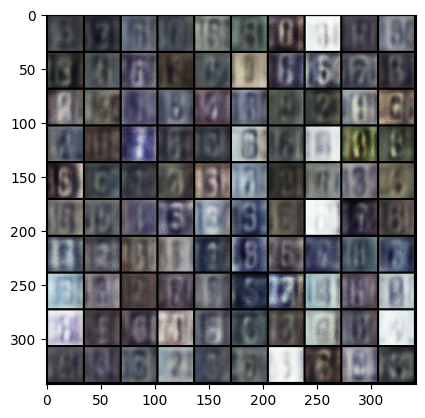

In [130]:
sample_image(n_row=10, batches_done=1555)

In [131]:
%load_ext tensorboard
%tensorboard --logdir=ctboard_logs/cgan

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 85058), started 0:30:33 ago. (Use '!kill 85058' to kill it.)